# Rt profile multicategorical versus uniform

In [1]:
# Import libraries
import os
import numpy as np
import math
import branchpro
import scipy.stats
from branchpro.apps import ReproductionNumberPlot
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
from cmdstanpy import CmdStanModel, cmdstan_path
import arviz as az
import nest_asyncio
import seaborn as sns
nest_asyncio.apply()

num_timepoints = 100 # number of days for incidence data
num_categories = 2

/Users/ioaros/opt/anaconda3/envs/testbranchpro2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# # Read contact matrix
# cm_file = 'UK'
# path = os.path.join('../data_library/contact_matrix', '{}.csv'.format(cm_file))
# contact_matrix = pd.read_csv(path, header=None)

# # Read serial interval
# si_file = 'si-epinow'
# path = os.path.join('../data_library/serial_interval', '{}.csv'.format(si_file))
# serial_interval = pd.read_csv(path, header=None)
# serial_interval = serial_interval.fillna(0)
# serial_intervals = serial_interval.values.T

# # Read transmissibility vector
# trans_file = 'UK'
# path = os.path.join('../data_library/transmissibility', '{}.csv'.format(trans_file))
# transmissibility = pd.read_csv(path, header=None)

In [3]:
# # Read Ontario data
# path = os.path.join('../data_library/covid_ontario/ON.csv')
# data = pd.read_csv(path)[:51]

## Parameterize example branching process model with disagregated data

In [4]:
# Build the serial interval w_s
ws_mean = 15.3
ws_var = 9.3**2
theta = ws_var / ws_mean
k = ws_mean / theta
w_dist = scipy.stats.gamma(k, scale=theta)
disc_w = w_dist.pdf(np.arange(num_timepoints))

# Simulate incidence data
initial_r = 1.2
serial_interval = disc_w

# contact_matrix = contact_matrix
contact_matrix = np.array([[8., 4.8], [1.2, 3.84]])
# contact_matrix = 1 * np.ones((2, 2))

transmissibility = [1, 0.5]
# transmissibility = [1.5, 1.5]

m = branchpro.MultiCatPoissonBranchProModel(
    initial_r, serial_interval, num_categories, contact_matrix, transmissibility)
new_rs = [0.5, 0.05, 0.2]          # sequence of R_0 numbers
start_times = [0, 30, 60]      # days at which each R_0 period begins
m.set_r_profile(new_rs, start_times)
parameters = [200, 20] # initial number of cases
times = np.arange(num_timepoints)

desagg_cases = m.simulate(parameters, times, var_contacts=True)
agg_cases = np.sum(desagg_cases, axis=1)

print(desagg_cases)

[[200.  20.]
 [  0.   0.]
 [  2.   0.]
 [ 12.   1.]
 [ 13.   3.]
 [ 23.   1.]
 [ 53.   1.]
 [ 41.   0.]
 [ 19.  11.]
 [ 32.   4.]
 [ 64.   1.]
 [ 44.   0.]
 [ 54.  41.]
 [ 92.   0.]
 [ 16.  16.]
 [ 85.  12.]
 [ 97.   3.]
 [ 94.  32.]
 [ 92.   3.]
 [ 68.  35.]
 [148.  44.]
 [184.   3.]
 [258.  25.]
 [174.  32.]
 [309.  46.]
 [295.  16.]
 [261.   1.]
 [378.  51.]
 [205.   8.]
 [592. 103.]
 [132. 118.]
 [ 75.   2.]
 [103.  10.]
 [ 42.  15.]
 [ 76.  25.]
 [ 27.  17.]
 [ 57.   0.]
 [112.  19.]
 [ 57.   2.]
 [ 74.  22.]
 [105.   4.]
 [ 67.   7.]
 [ 79.  10.]
 [ 45.   2.]
 [ 43.   3.]
 [101.  42.]
 [ 90.   2.]
 [ 79.  20.]
 [ 57.  14.]
 [ 56.   4.]
 [ 33.   0.]
 [ 25.   3.]
 [ 48.   1.]
 [ 24.  15.]
 [ 59.   9.]
 [ 59.   7.]
 [ 30.  15.]
 [ 37.   3.]
 [ 38.   1.]
 [ 31.   4.]
 [ 22.   7.]
 [ 46.  47.]
 [ 57.  24.]
 [112.  44.]
 [138.   7.]
 [109.  14.]
 [101.  16.]
 [106.   4.]
 [ 94.  26.]
 [ 53.   9.]
 [ 75.   3.]
 [ 92.  69.]
 [ 49.   2.]
 [168.   7.]
 [121.  18.]
 [110.  28.]
 [220.   4.]

## Plot agreggated local incidence numbers

In [5]:
# Plot (bar chart cases each day)
fig = go.Figure()

# Plot of incidences
fig.add_trace(
    go.Bar(
        x=times,
        y=agg_cases,
        name='Incidences'
    )
)

# Add axis labels
fig.update_layout(
    xaxis_title='Time (days)',
    yaxis_title='New cases'
)

fig.show()

In [33]:
fig = go.Figure()

fig.add_trace(
    go.Bar(
        y=desagg_cases[:, 0],
        x=times,
        name='Incidence group 1'
    )
)

fig.add_trace(
    go.Bar(
        y=desagg_cases[:, 1],
        x=times,
        name='Incidence group 2'
    )
)

# Add axis labels
fig.update_layout(
    barmode='stack', 
    width=900,
    height=600,
    font=dict(
            size=16),
    plot_bgcolor='white',
    xaxis=dict(
        title='Time (days)',
        linecolor='black'),
    yaxis=dict(
        title='New infections',
        linecolor='black',
        title_standoff=5),
    legend=dict(
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=0.95,
            bordercolor="Black",
            borderwidth=1
        )
    )

fig.write_image('images/Figire_3_4_Incidence.pdf')
fig.show()

## R_t inference using STAN

In [7]:
# Same inference, but using the PoissonBranchProPosterior
tau = 6
R_t_start = tau+1
a = 1
b = 1/5
sigma = 1.5

# Correction for reproduction number per category
correc_i = np.multiply(np.sum(contact_matrix, axis=0), transmissibility)
correc_e = np.multiply(np.sum(m.exact_contact_matrix, axis=1), transmissibility)

In [8]:
# Transform our incidence data into pandas dataframes
multicat_inc_data_matrix = {'Time': np.arange(num_timepoints)}

for _ in range(num_categories):
    multicat_inc_data_matrix['Incidence Number Cat {}'.format(_+1)] = \
        desagg_cases[:, _]

multicat_inc_data = pd.DataFrame(multicat_inc_data_matrix)

# Transform our incidence data into pandas dataframes
inc_data = pd.DataFrame(
    {
        'Time': np.arange(num_timepoints),
        'Incidence Number': agg_cases
    }
)

L1 = len(np.arange(R_t_start, start_times[1]+1))
L2 = len(np.arange(start_times[1]+1, start_times[2]+1))
L3 = len(np.arange(start_times[2]+1, num_timepoints))

ground_truth = []
for j in range(num_categories):
    ground_truth.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'R_t': (0.5*correc_e[R_t_start:(start_times[1]+1), j]).tolist() + (0.05*correc_e[(start_times[1]+1):(start_times[2]+1), j]).tolist() + (0.2*correc_e[(start_times[2]+1):num_timepoints, j]).tolist()
    }))

## 1. Exact Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [9]:
exact_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/exact_multicat.stan'))

exact_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': np.array(m.exact_contact_matrix),
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18387/3829575306.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [10]:
fit = exact_multicat_model.sample(
    data=exact_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:17:15 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status

chain 1 |▉         | 00:28 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:46 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 01:01 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 01:15 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 01:32 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 01:47 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 02:01 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 02:14 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 02:27 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▍    | 02:43 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 02:58 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 03:13 Iteration: 1100 / 2000 [ 55%]  (Sampling)

chain 1 |██████▊   | 03:28 Iteration: 1200 / 2000 [ 60%]  (Samplin


12:22:25 - cmdstanpy - INFO - CmdStan done processing.
12:22:25 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.538,0.044,0.455,0.619,0.001,0.0,4219.0,2360.0,1.0
R[1],0.515,0.039,0.441,0.583,0.001,0.0,3649.0,2289.0,1.0
R[2],0.497,0.034,0.433,0.559,0.001,0.0,3601.0,2396.0,1.0
R[3],0.533,0.034,0.467,0.594,0.001,0.0,4452.0,2094.0,1.0
R[4],0.518,0.030,0.463,0.574,0.000,0.0,4240.0,2503.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.202,0.005,0.193,0.209,0.000,0.0,4205.0,2288.0,1.0
R[89],0.204,0.004,0.196,0.212,0.000,0.0,3559.0,2315.0,1.0
R[90],0.207,0.004,0.199,0.215,0.000,0.0,4393.0,2471.0,1.0
R[91],0.205,0.004,0.196,0.213,0.000,0.0,3782.0,2148.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

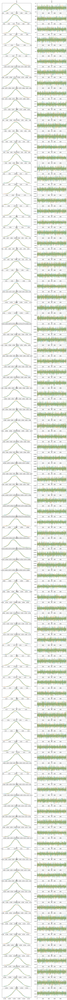

In [11]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [12]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
exact_multicat_intervals = []

for j in range(num_categories):
    exact_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], axis=0),
        'Lower bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 2. Average Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [13]:
approx_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/approx_multicat.stan'))

approx_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18387/2726440678.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [14]:
fit = approx_multicat_model.sample(data=approx_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:22:33 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▉         | 00:23 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:43 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 01:01 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 01:18 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 01:35 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 01:50 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 02:06 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 02:20 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 02:34 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 02:51 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 03:08 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 03:25 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 03:42 Iteration: 1200 / 2000 [ 60%]  (Sampling)

chain 1 |███████▎  | 03:59 Itera


12:28:40 - cmdstanpy - INFO - CmdStan done processing.
12:28:40 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive fin

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.493,0.040,0.420,0.568,0.001,0.0,3845.0,2051.0,1.0
R[1],0.440,0.033,0.382,0.503,0.001,0.0,3657.0,2274.0,1.0
R[2],0.413,0.029,0.362,0.470,0.000,0.0,3745.0,2271.0,1.0
R[3],0.424,0.027,0.371,0.473,0.000,0.0,3270.0,2511.0,1.0
R[4],0.403,0.023,0.358,0.447,0.000,0.0,3568.0,2343.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.187,0.004,0.179,0.195,0.000,0.0,3845.0,2119.0,1.0
R[89],0.205,0.004,0.197,0.213,0.000,0.0,3857.0,2037.0,1.0
R[90],0.226,0.005,0.217,0.234,0.000,0.0,3488.0,2042.0,1.0
R[91],0.219,0.004,0.210,0.227,0.000,0.0,3882.0,2112.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

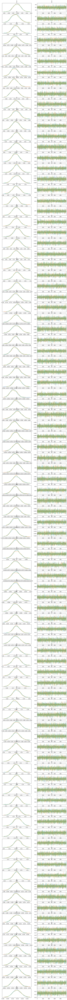

In [15]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [16]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
approx_multicat_intervals = []

for j in range(num_categories):
    approx_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 3. Average Contact data + Total cases + Poisson Branching process with multiple categories

In [17]:
agg_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/agg_multicat.stan'))

agg_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18387/3052504579.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [18]:
fit = agg_multicat_model.sample(data=agg_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:28:48 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status

chain 1 |▉         | 16:48 Iteration:    1 / 2000 [  0%]  (Warmup)

chain 1 |█▎        | 18:49 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 20:21 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 21:27 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 22:38 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 23:44 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 24:47 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 25:43 Iteration:  700 / 2000 [ 35%]  (Warmup)

chain 1 |████▌     | 26:33 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 28:03 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 29:21 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 30:37 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 31:50 Iteration: 1200 / 2000 [ 60%]  (Samplin


13:08:07 - cmdstanpy - INFO - CmdStan done processing.
13:08:07 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_mult

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.509,0.052,0.417,0.605,0.002,0.001,897.0,1301.0,1.01
R[1],0.459,0.042,0.386,0.544,0.001,0.001,856.0,1670.0,1.01
R[2],0.432,0.040,0.361,0.509,0.001,0.001,867.0,1243.0,1.01
R[3],0.447,0.037,0.379,0.516,0.001,0.001,868.0,1401.0,1.01
R[4],0.425,0.033,0.362,0.484,0.001,0.001,793.0,1644.0,1.01
...,...,...,...,...,...,...,...,...,...
"p[97, 1]",0.509,0.283,0.065,1.000,0.004,0.003,3629.0,1585.0,1.00
"p[98, 0]",0.509,0.292,0.063,0.997,0.005,0.004,3332.0,1655.0,1.00
"p[98, 1]",0.491,0.292,0.003,0.937,0.005,0.003,3332.0,1655.0,1.00
"p[99, 0]",0.513,0.282,0.047,0.969,0.004,0.003,3920.0,2004.0,1.00


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

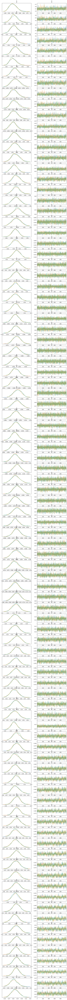

In [19]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

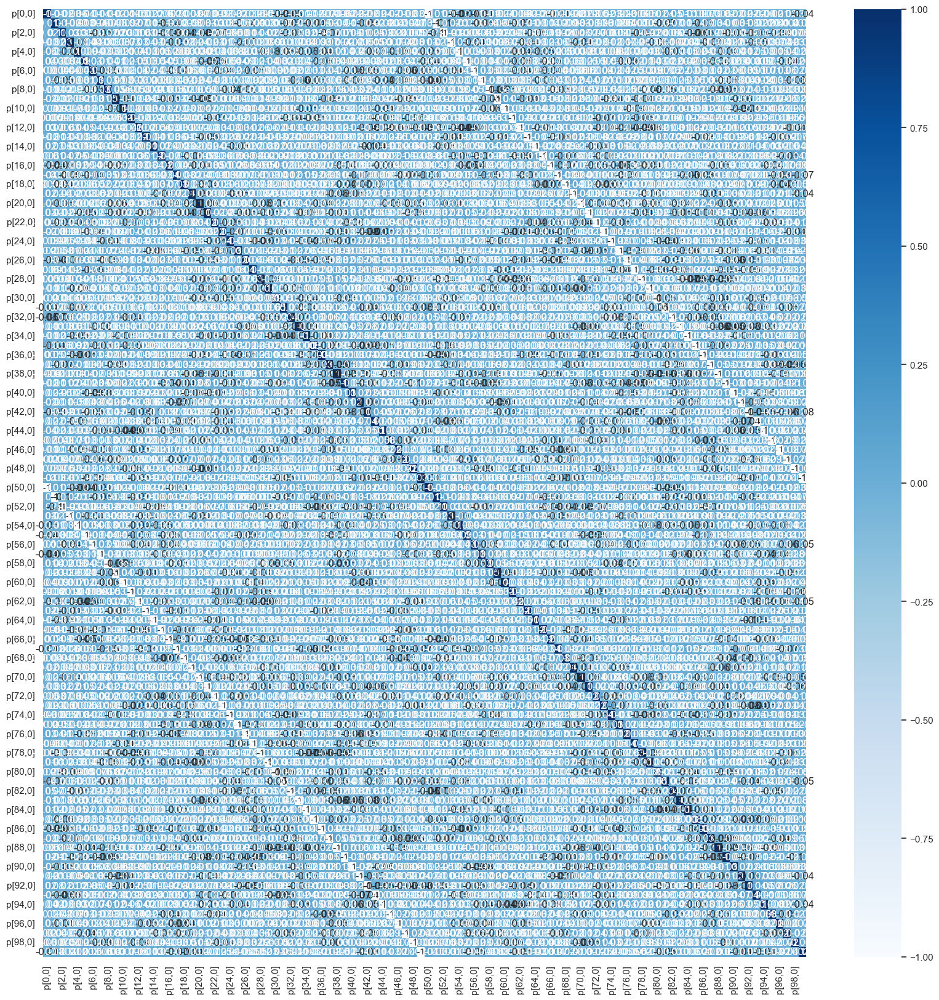

In [20]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
p_chain_samples = fit.draws()[500:, :, (num_timepoints - R_t_start +7)::num_categories]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = p_chain_samples.shape

extended_p_samples = np.concatenate((
    p_chain_samples[:, 0, :],
    p_chain_samples[:, 1, :],
    p_chain_samples[:, 2, :]), axis=0)

df = pd.DataFrame(
    extended_p_samples,
    columns=[
        'p[{},0]'.format(_)
        for _ in range(num_timepoints)])

plt.figure(figsize=(20,20))
sns.set_theme(style="white")
corr = df.corr()
heatmap = sns.heatmap(corr, annot=True, cmap="Blues", fmt='.1g')

In [21]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:(num_timepoints - R_t_start +7)]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
agg_multicat_intervals = []

for j in range(num_categories):
    agg_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 4. No Contact data + Total cases + Poisson Branching process

In [22]:
poisson_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/poisson_one.stan'))

poisson_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18387/3414372969.py:7: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [23]:
fit = poisson_model.sample(
    data=poisson_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:08:21 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▉         | 00:00 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:01 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 00:01 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 00:02 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 00:02 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 00:03 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 00:03 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 00:03 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 00:04 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████     | 00:04 Iteration:  900 / 2000 [ 45%]  (Warmup)
chain 1 |█████▉    | 00:05 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 00:05 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 00:05 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 00:06 Iterati


13:08:30 - cmdstanpy - INFO - CmdStan done processing.
13:08:30 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'po

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],4.279,0.349,3.644,4.946,0.006,0.004,3423.0,1649.0,1.0
R[1],3.838,0.276,3.318,4.375,0.004,0.003,3758.0,2199.0,1.0
R[2],3.609,0.239,3.177,4.050,0.004,0.003,3701.0,2100.0,1.0
R[3],3.716,0.230,3.276,4.137,0.004,0.003,3734.0,2343.0,1.0
R[4],3.524,0.204,3.174,3.938,0.003,0.002,4782.0,2235.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],1.591,0.037,1.519,1.657,0.001,0.000,3859.0,2162.0,1.0
R[89],1.745,0.037,1.678,1.815,0.001,0.000,3744.0,2170.0,1.0
R[90],1.915,0.039,1.843,1.987,0.001,0.000,4421.0,2256.0,1.0
R[91],1.852,0.039,1.784,1.929,0.001,0.000,3499.0,2176.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

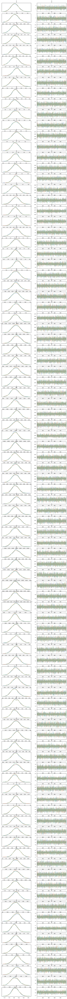

In [24]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [25]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))

pois_intervals = pd.DataFrame({
    'Time Points': np.arange(R_t_start, num_timepoints),
    'Mean': np.mean(extended_samples[::thinning, :], axis=0),
    'Lower bound CI': np.quantile(extended_samples[::thinning, :], 0.025, axis=0),
    'Upper bound CI': np.quantile(extended_samples[::thinning, :], 0.975, axis=0),
    'Central Probability': (L1+L2+L3) * [0.95]
})

## Inference plot using class method results

In [26]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1,
            itemwidth=50
        )
)

fig.figure.write_image('images/Figure 3.pdf')

fig.show_figure()

/Users/ioaros/Desktop/Software Project/branchpro/branchpro/apps/_reproduction_number_plot.py:27: UserWarning:

Labels do not match. They will be updated.



In [27]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3 Perfect.pdf')

fig.show_figure()

In [28]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4.pdf')

fig.show_figure()

In [29]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4 Perfect.pdf')

fig.show_figure()

In [38]:
fig = ReproductionNumberPlot()

for j in range(num_categories):
    fig.add_ground_truth_rt(ground_truth[j], shape=[None, 'dash'][j])
    fig.figure.data[5*j]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

    fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1), shape=[None, 'longdash'][j])
    fig.figure.data[5*j+1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

    fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
    fig.figure.data[5*j+3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[10]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][5*j+2]['showlegend'] = False
        fig.figure['data'][5*j+4]['showlegend'] = False
fig.figure['data'][-1]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3 All.pdf')

fig.show_figure()

/Users/ioaros/Desktop/Software Project/branchpro/branchpro/apps/_reproduction_number_plot.py:27: UserWarning:

Labels do not match. They will be updated.



In [37]:
fig = ReproductionNumberPlot()

for j in range(num_categories):
    fig.add_ground_truth_rt(ground_truth[j], shape=[None, 'dash'][j])
    fig.figure.data[3*j]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

    fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1), shape=[None, 'dash'][j])
    fig.figure.data[3*j+1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[6]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][3*i+2]['showlegend'] = False
fig.figure['data'][-1]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4 All.pdf')

fig.show_figure()